In [196]:
import pandas as pd
import duckdb

In [197]:
import pandas as pd
import streamlit as st
import duckdb
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

st.title("🚗 Data Insights" )
@st.cache_data
def load_data():
    con = duckdb.connect(database=':memory:', read_only=False)
    path=r"C:\Users\Shaaf\Desktop\Data Science\Practice Projects\Transport Planning\Sampled_Data\combined_sampled_data.parquet"
    df = con.execute(f"SELECT * FROM '{path}'").df()
    return df
data = load_data()


2025-12-17 12:19:58.908 No runtime found, using MemoryCacheStorageManager


In [198]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,23.30,2.50,0.5,5.45,0.0,1.0,32.75,2.5,0.0,0.00
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,13.58,0.00,0.5,3.02,0.0,1.0,18.10,NaN,NaN,0.00
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,13.50,0.00,0.5,0.00,0.0,1.0,18.25,2.5,0.0,0.75
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,10.70,2.50,0.5,0.00,0.0,1.0,17.95,2.5,0.0,0.75
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,7.90,0.00,0.5,2.82,0.0,1.0,12.22,0.0,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,5.80,4.25,0.5,2.30,0.0,1.0,13.85,2.5,0.0,0.75
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,5.80,2.50,0.5,0.00,0.0,1.0,9.80,2.5,0.0,0.00
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,-2.88,0.00,0.5,0.00,0.0,1.0,7.23,NaN,NaN,0.75
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,19.10,0.00,0.5,4.12,0.0,1.0,24.72,0.0,0.0,0.00


In [199]:

#Famous Cab Companies
company_counts = pd.DataFrame(data['VendorID'].value_counts()).rename_axis("VendorID").reset_index()


In [200]:
company_counts

,VendorID,count
0,2,3184581
1,1,795407
2,7,42063
3,6,1569


In [201]:
fig = px.bar(
    company_counts,
    x="VendorID",
    y="count",
    text="count",
    title="Number of Rides by Cab Company"
)

fig.update_traces(textposition="outside")

fig.show()

In [202]:
company_counts = pd.DataFrame(data['VendorID'].value_counts()).rename_axis("VendorID").reset_index()
company_counts.sort_values(by="count",inplace=True,ascending=False)
st.subheader("🚕 Famous Cab Companies")

fig = px.bar(
    company_counts,
    x="VendorID",
    y="count",
    text="count",
    title="Number of Rides by Cab Company"
)

fig.update_traces(textposition="outside")

fig.update_layout(width=700, height=400)
st.plotly_chart(fig)
fig.show()

In [203]:
company_counts

,VendorID,count
0,2,3184581
1,1,795407
2,7,42063
3,6,1569


In [204]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,23.30,2.50,0.5,5.45,0.0,1.0,32.75,2.5,0.0,0.00
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,13.58,0.00,0.5,3.02,0.0,1.0,18.10,NaN,NaN,0.00
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,13.50,0.00,0.5,0.00,0.0,1.0,18.25,2.5,0.0,0.75
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,10.70,2.50,0.5,0.00,0.0,1.0,17.95,2.5,0.0,0.75
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,7.90,0.00,0.5,2.82,0.0,1.0,12.22,0.0,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,5.80,4.25,0.5,2.30,0.0,1.0,13.85,2.5,0.0,0.75
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,5.80,2.50,0.5,0.00,0.0,1.0,9.80,2.5,0.0,0.00
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,-2.88,0.00,0.5,0.00,0.0,1.0,7.23,NaN,NaN,0.75
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,19.10,0.00,0.5,4.12,0.0,1.0,24.72,0.0,0.0,0.00


In [205]:
data['Date'] = pd.to_datetime(data['tpep_pickup_datetime']).dt.date

In [206]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,2.50,0.5,5.45,0.0,1.0,32.75,2.5,0.0,0.00,2025-01-08
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,0.00,0.5,3.02,0.0,1.0,18.10,NaN,NaN,0.00,2025-01-12
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,0.00,0.5,0.00,0.0,1.0,18.25,2.5,0.0,0.75,2025-01-22
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,2.50,0.5,0.00,0.0,1.0,17.95,2.5,0.0,0.75,2025-01-21
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,0.00,0.5,2.82,0.0,1.0,12.22,0.0,0.0,0.00,2025-01-17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,4.25,0.5,2.30,0.0,1.0,13.85,2.5,0.0,0.75,2025-10-26
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,2.50,0.5,0.00,0.0,1.0,9.80,2.5,0.0,0.00,2025-10-04
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,0.00,0.5,0.00,0.0,1.0,7.23,NaN,NaN,0.75,2025-10-21
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,0.00,0.5,4.12,0.0,1.0,24.72,0.0,0.0,0.00,2025-10-04


In [207]:
data.reset_index(drop=True,inplace=True)

In [208]:
data.duplicated().sum()

0

In [209]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,2.50,0.5,5.45,0.0,1.0,32.75,2.5,0.0,0.00,2025-01-08
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,0.00,0.5,3.02,0.0,1.0,18.10,NaN,NaN,0.00,2025-01-12
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,0.00,0.5,0.00,0.0,1.0,18.25,2.5,0.0,0.75,2025-01-22
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,2.50,0.5,0.00,0.0,1.0,17.95,2.5,0.0,0.75,2025-01-21
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,0.00,0.5,2.82,0.0,1.0,12.22,0.0,0.0,0.00,2025-01-17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,4.25,0.5,2.30,0.0,1.0,13.85,2.5,0.0,0.75,2025-10-26
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,2.50,0.5,0.00,0.0,1.0,9.80,2.5,0.0,0.00,2025-10-04
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,0.00,0.5,0.00,0.0,1.0,7.23,NaN,NaN,0.75,2025-10-21
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,0.00,0.5,4.12,0.0,1.0,24.72,0.0,0.0,0.00,2025-10-04


In [210]:
data=data[data['tpep_pickup_datetime'].dt.year==2025]

In [211]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,2.50,0.5,5.45,0.0,1.0,32.75,2.5,0.0,0.00,2025-01-08
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,0.00,0.5,3.02,0.0,1.0,18.10,NaN,NaN,0.00,2025-01-12
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,0.00,0.5,0.00,0.0,1.0,18.25,2.5,0.0,0.75,2025-01-22
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,2.50,0.5,0.00,0.0,1.0,17.95,2.5,0.0,0.75,2025-01-21
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,0.00,0.5,2.82,0.0,1.0,12.22,0.0,0.0,0.00,2025-01-17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,4.25,0.5,2.30,0.0,1.0,13.85,2.5,0.0,0.75,2025-10-26
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,2.50,0.5,0.00,0.0,1.0,9.80,2.5,0.0,0.00,2025-10-04
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,0.00,0.5,0.00,0.0,1.0,7.23,NaN,NaN,0.75,2025-10-21
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,0.00,0.5,4.12,0.0,1.0,24.72,0.0,0.0,0.00,2025-10-04


In [212]:
data['Date'] = pd.to_datetime(data['Date'])
df_resampled=data.set_index('Date')

C:\Users\Shaaf\AppData\Local\Temp\ipykernel_24484\1863174425.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [213]:
df_resampled

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee
Date,,,,,,,,,,,,,,,,,,,,
2025-01-08,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,23.30,2.50,0.5,5.45,0.0,1.0,32.75,2.5,0.0,0.00
2025-01-12,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,13.58,0.00,0.5,3.02,0.0,1.0,18.10,NaN,NaN,0.00
2025-01-22,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,13.50,0.00,0.5,0.00,0.0,1.0,18.25,2.5,0.0,0.75
2025-01-21,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,10.70,2.50,0.5,0.00,0.0,1.0,17.95,2.5,0.0,0.75
2025-01-17,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,7.90,0.00,0.5,2.82,0.0,1.0,12.22,0.0,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-10-26,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,5.80,4.25,0.5,2.30,0.0,1.0,13.85,2.5,0.0,0.75
2025-10-04,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,5.80,2.50,0.5,0.00,0.0,1.0,9.80,2.5,0.0,0.00
2025-10-21,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,-2.88,0.00,0.5,0.00,0.0,1.0,7.23,NaN,NaN,0.75


In [214]:
df_resampled =df_resampled.resample('W').size()
df_resampled=pd.DataFrame(df_resampled,columns=['passenger_count'])
df_resampled

,passenger_count
Date,
2025-01-05,44440
2025-01-12,74998
2025-01-19,84559
2025-01-26,83985
2025-02-02,86865
2025-02-09,87795
2025-02-16,92882
2025-02-23,85990
2025-03-02,93034


In [215]:
plotly_fig = px.line(
    df_resampled,
    x=df_resampled.index,
    y='passenger_count',
    title='Weekly Passenger Count Over Time',
    labels={'passenger_count': 'Number of Passengers', 'Date': 'Date'}
)

In [216]:
plt.figure(figsize=(12,6))
plotly_fig.show()

<Figure size 1200x600 with 0 Axes>

In [217]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,2.50,0.5,5.45,0.0,1.0,32.75,2.5,0.0,0.00,2025-01-08
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,0.00,0.5,3.02,0.0,1.0,18.10,NaN,NaN,0.00,2025-01-12
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,0.00,0.5,0.00,0.0,1.0,18.25,2.5,0.0,0.75,2025-01-22
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,2.50,0.5,0.00,0.0,1.0,17.95,2.5,0.0,0.75,2025-01-21
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,0.00,0.5,2.82,0.0,1.0,12.22,0.0,0.0,0.00,2025-01-17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,4.25,0.5,2.30,0.0,1.0,13.85,2.5,0.0,0.75,2025-10-26
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,2.50,0.5,0.00,0.0,1.0,9.80,2.5,0.0,0.00,2025-10-04
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,0.00,0.5,0.00,0.0,1.0,7.23,NaN,NaN,0.75,2025-10-21
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,0.00,0.5,4.12,0.0,1.0,24.72,0.0,0.0,0.00,2025-10-04


In [218]:
data['Hour'] = pd.to_datetime(data['tpep_pickup_datetime']).dt.hour
data

C:\Users\Shaaf\AppData\Local\Temp\ipykernel_24484\2154520599.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date,Hour
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,0.5,5.45,0.0,1.0,32.75,2.5,0.0,0.00,2025-01-08,12
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,0.5,3.02,0.0,1.0,18.10,NaN,NaN,0.00,2025-01-12,15
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,0.5,0.00,0.0,1.0,18.25,2.5,0.0,0.75,2025-01-22,10
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,0.5,0.00,0.0,1.0,17.95,2.5,0.0,0.75,2025-01-21,19
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,0.5,2.82,0.0,1.0,12.22,0.0,0.0,0.00,2025-01-17,14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,0.5,2.30,0.0,1.0,13.85,2.5,0.0,0.75,2025-10-26,21
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,0.5,0.00,0.0,1.0,9.80,2.5,0.0,0.00,2025-10-04,12
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,0.5,0.00,0.0,1.0,7.23,NaN,NaN,0.75,2025-10-21,20
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,0.5,4.12,0.0,1.0,24.72,0.0,0.0,0.00,2025-10-04,15


In [219]:
data.dtypes

VendorID                          int32
tpep_pickup_datetime     datetime64[us]
tpep_dropoff_datetime    datetime64[us]
passenger_count                 float64
trip_distance                   float64
RatecodeID                      float64
store_and_fwd_flag               object
PULocationID                      int32
DOLocationID                      int32
payment_type                      int64
fare_amount                     float64
extra                           float64
mta_tax                         float64
tip_amount                      float64
tolls_amount                    float64
improvement_surcharge           float64
total_amount                    float64
congestion_surcharge            float64
Airport_fee                     float64
cbd_congestion_fee              float64
Date                     datetime64[ns]
Hour                              int32
dtype: object

In [220]:
print(f"mean amount{data['total_amount'].mean()}")
print(f"max amount{data['total_amount'].max()}")
print(f"min amount{data['total_amount'].min()}")

mean amount26.57587260520258
max amount3240.61
min amount-936.99


In [221]:
negative_values=(data['total_amount']<0).sum()
percent_negative = (negative_values / len(data)) * 100
print(f"Number of negative total_amount entries: {negative_values}")
print(f"Percentage of negative total_amount entries: {percent_negative:.2f}%")

Number of negative total_amount entries: 79798
Percentage of negative total_amount entries: 1.98%


<Axes: xlabel='total_amount'>

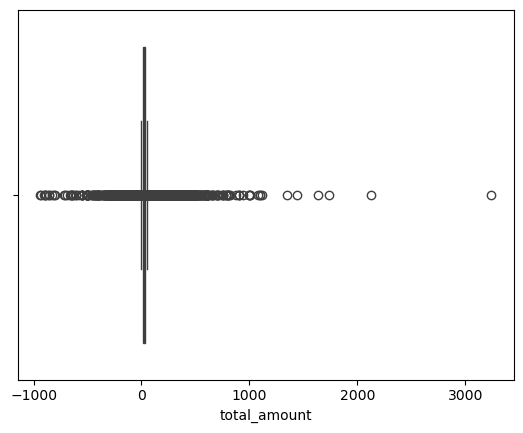

In [222]:
sns.boxplot(x=data['total_amount'])

In [246]:
negative_data = data[data['total_amount'] < 0]
negative_data.head(100)

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date,Hour,Month
13,2,2025-01-03 22:12:49,2025-01-03 22:20:54,1.0,1.02,1.0,N,230,164,2,...,0.0,0.0,-1.0,-13.60,-2.5,0.00,0.0,2025-01-03,22,1
19,2,2025-01-22 16:31:52,2025-01-22 16:32:00,1.0,0.00,1.0,N,193,193,3,...,0.0,0.0,-1.0,-8.75,0.0,-1.75,0.0,2025-01-22,16,1
65,2,2025-01-01 02:07:05,2025-01-01 02:42:12,1.0,8.27,1.0,N,100,244,4,...,0.0,0.0,-1.0,-49.30,-2.5,0.00,0.0,2025-01-01,2,1
340,2,2025-01-29 21:45:57,2025-01-29 21:51:41,1.0,0.72,1.0,N,140,237,4,...,0.0,0.0,-1.0,-12.20,-2.5,0.00,0.0,2025-01-29,21,1
431,2,2025-01-14 11:43:22,2025-01-14 11:56:50,1.0,1.40,1.0,N,13,87,4,...,0.0,0.0,-1.0,-17.55,-2.5,0.00,0.0,2025-01-14,11,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5949,2,2025-01-06 15:32:19,2025-01-06 16:25:35,1.0,27.00,1.0,N,132,247,4,...,0.0,0.0,-1.0,-106.00,0.0,0.00,0.0,2025-01-06,15,1
5985,2,2025-01-14 07:34:19,2025-01-14 07:39:30,1.0,0.05,1.0,N,262,262,4,...,0.0,0.0,-1.0,-9.80,-2.5,0.00,0.0,2025-01-14,7,1
6006,2,2025-01-16 16:17:39,2025-01-16 16:18:57,1.0,0.21,1.0,N,186,164,2,...,0.0,0.0,-1.0,-10.95,-2.5,0.00,0.0,2025-01-16,16,1
6042,2,2025-01-10 16:50:43,2025-01-10 17:06:31,2.0,1.89,1.0,N,246,107,3,...,0.0,0.0,-1.0,-22.15,-2.5,0.00,0.0,2025-01-10,16,1


In [253]:
data_for_pairplot=negative_data.select_dtypes(include=['float64', 'int64'])

In [254]:
data_for_pairplot

,passenger_count,trip_distance,RatecodeID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee
13,1.0,1.02,1.0,2,-8.60,-1.0,-0.5,0.0,0.0,-1.0,-13.60,-2.5,0.00,0.00
19,1.0,0.00,1.0,3,-3.00,-2.5,-0.5,0.0,0.0,-1.0,-8.75,0.0,-1.75,0.00
65,1.0,8.27,1.0,4,-44.30,-1.0,-0.5,0.0,0.0,-1.0,-49.30,-2.5,0.00,0.00
340,1.0,0.72,1.0,4,-7.20,-1.0,-0.5,0.0,0.0,-1.0,-12.20,-2.5,0.00,0.00
431,1.0,1.40,1.0,4,-12.80,0.0,-0.5,0.0,0.0,-1.0,-17.55,-2.5,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023277,1.0,12.09,1.0,3,-54.10,-2.5,-0.5,0.0,0.0,-1.0,-59.85,0.0,-1.75,0.00
4023473,1.0,0.10,1.0,4,-3.00,-2.5,-0.5,0.0,0.0,-1.0,-10.25,-2.5,0.00,-0.75
4023518,NaN,9.55,NaN,0,-5.52,0.0,0.5,0.0,0.0,1.0,-4.02,NaN,NaN,0.00
4023519,NaN,4.50,NaN,0,-10.29,0.0,0.5,0.0,0.0,1.0,-5.54,NaN,NaN,0.75


In [258]:
data['RatecodeID'].unique()

array([ 1., nan,  2.,  5., 99.,  4.,  3.,  6.])

In [259]:
data['RatecodeID'].value_counts()

RatecodeID
1.0     2857278
2.0      109728
99.0      58006
5.0       36723
3.0       12120
4.0        9548
6.0           3
Name: count, dtype: int64

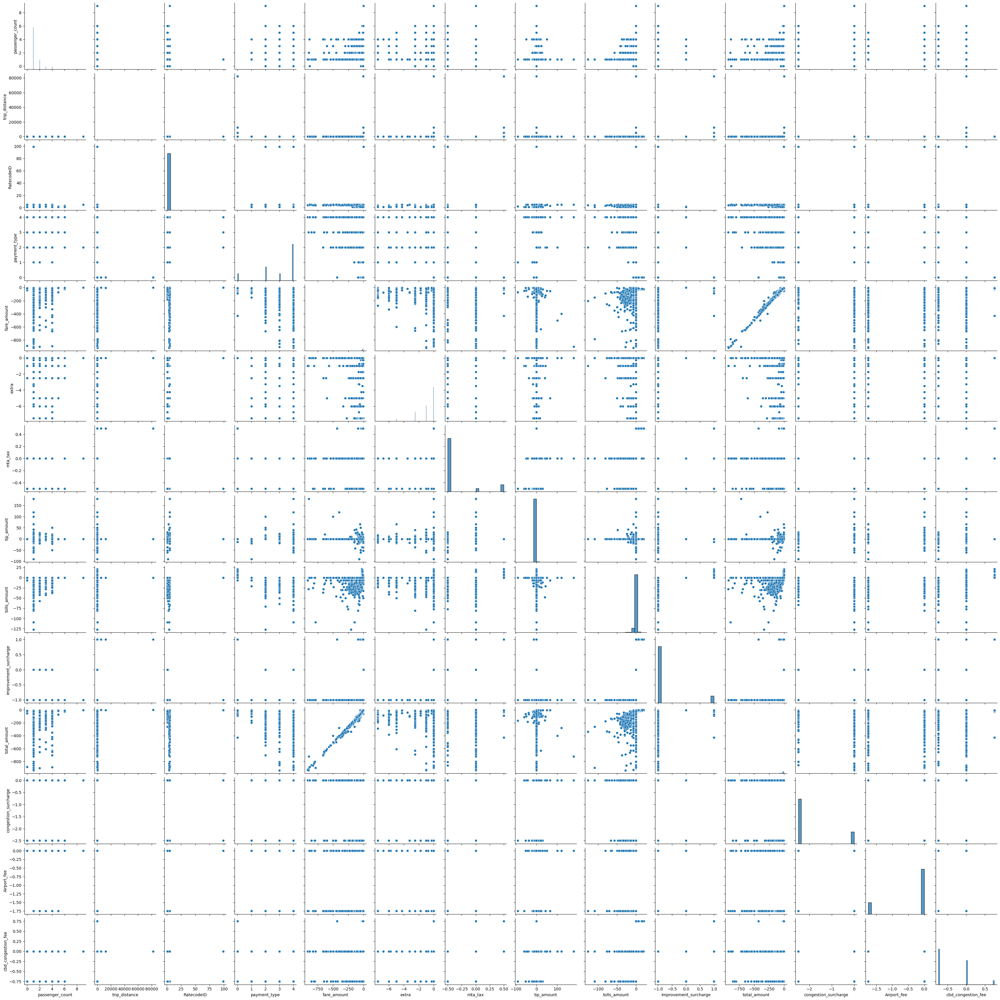

In [255]:
sns.pairplot(data_for_pairplot)

<Axes: >

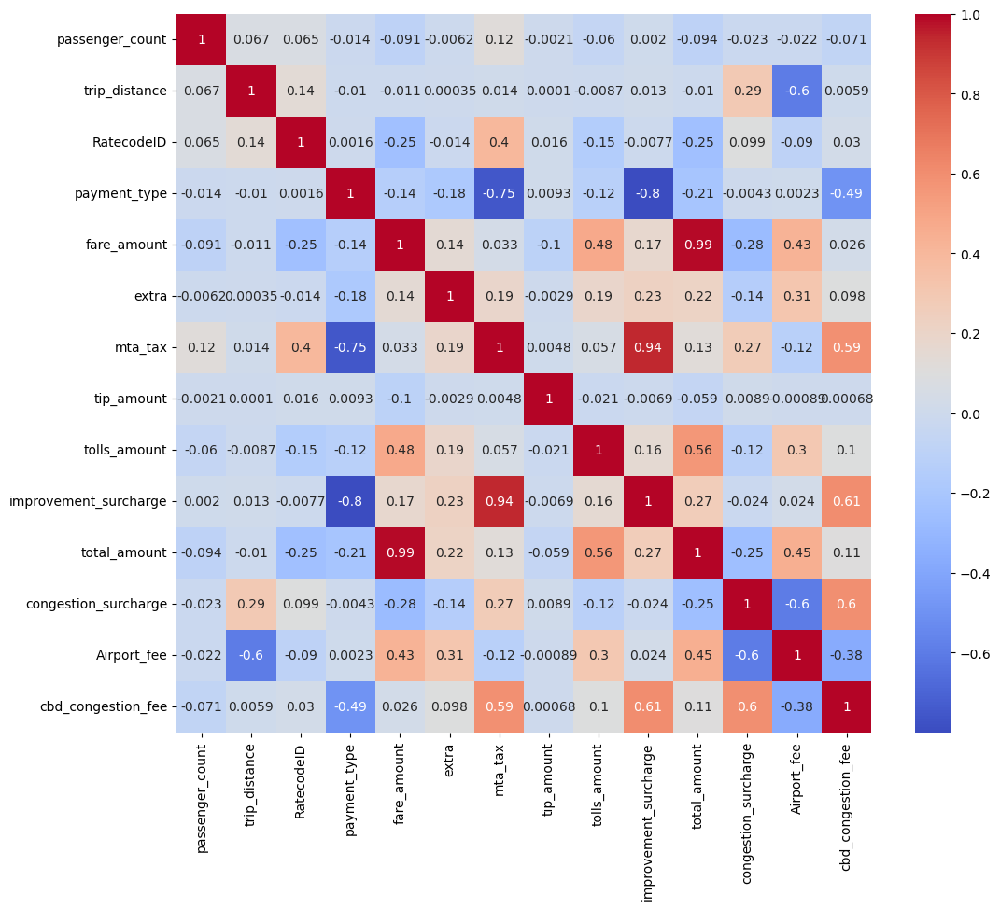

In [257]:
plt.figure(figsize=(12,10))
sns.heatmap(data_for_pairplot.corr(), annot=True, cmap='coolwarm')


In [248]:
negative_data['Month'].value_counts()

Month
5     11231
10    10766
8      8752
9      7732
7      7715
6      7488
4      7404
3      6820
1      6397
2      5493
Name: count, dtype: int64

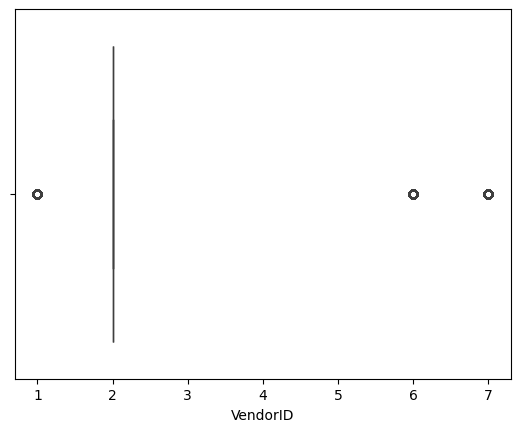

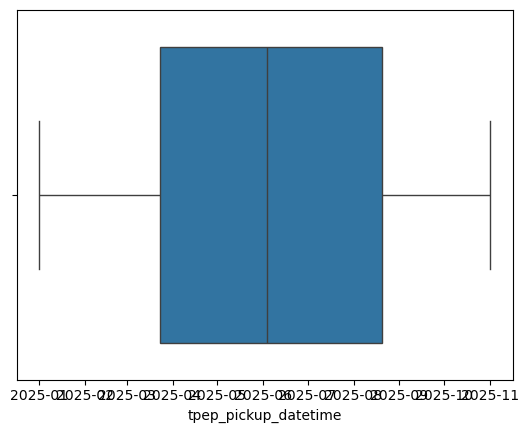

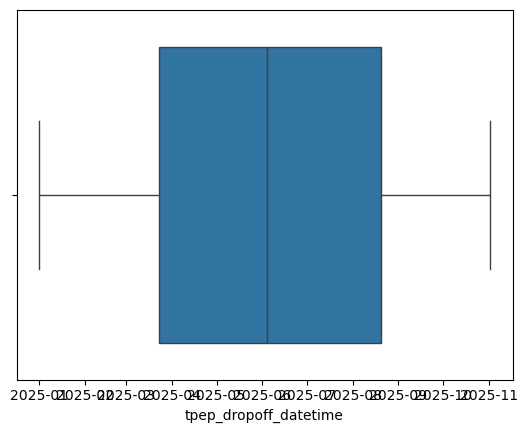

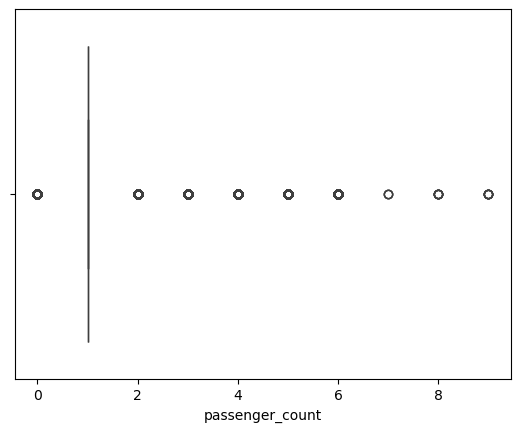

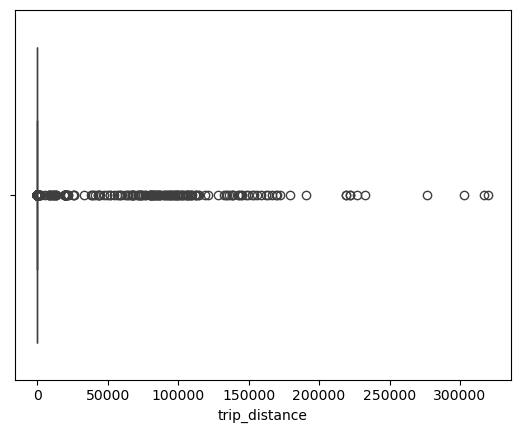

...

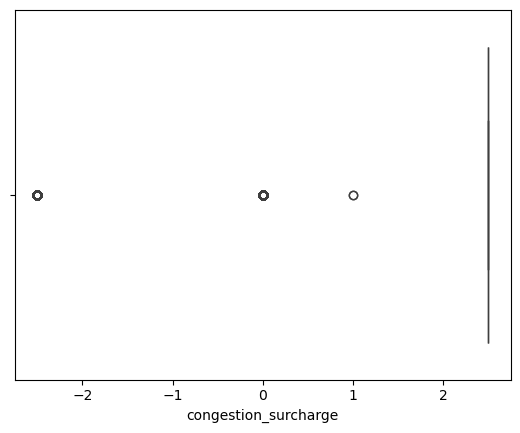

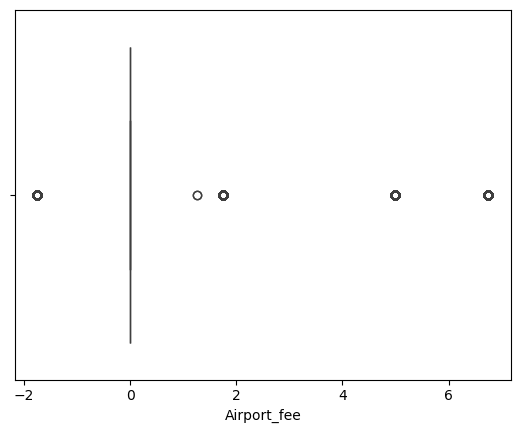

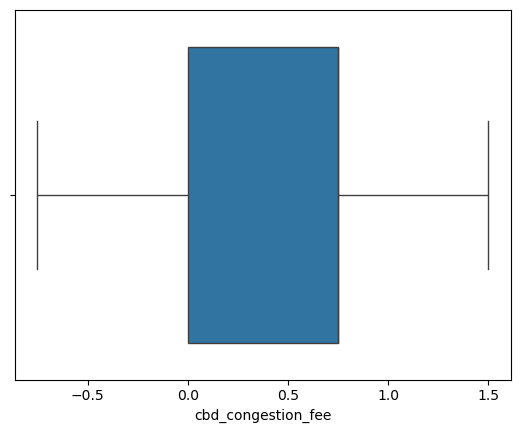

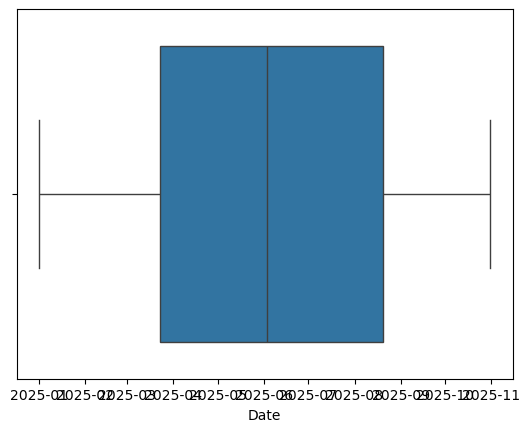

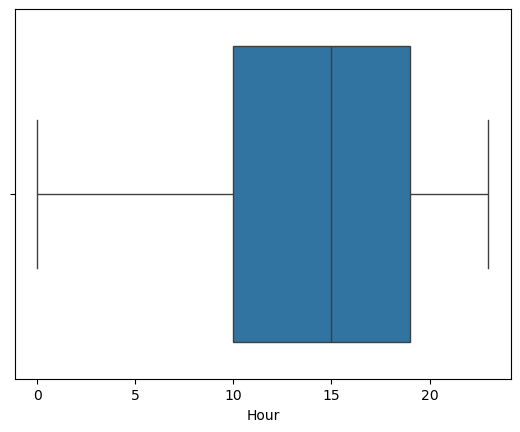

In [224]:
colums = data.columns
for i in colums:
    sns.boxplot(x=data[i])
    plt.show()

In [225]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date,Hour
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,0.5,5.45,0.0,1.0,32.75,2.5,0.0,0.00,2025-01-08,12
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,0.5,3.02,0.0,1.0,18.10,NaN,NaN,0.00,2025-01-12,15
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,0.5,0.00,0.0,1.0,18.25,2.5,0.0,0.75,2025-01-22,10
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,0.5,0.00,0.0,1.0,17.95,2.5,0.0,0.75,2025-01-21,19
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,0.5,2.82,0.0,1.0,12.22,0.0,0.0,0.00,2025-01-17,14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,0.5,2.30,0.0,1.0,13.85,2.5,0.0,0.75,2025-10-26,21
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,0.5,0.00,0.0,1.0,9.80,2.5,0.0,0.00,2025-10-04,12
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,0.5,0.00,0.0,1.0,7.23,NaN,NaN,0.75,2025-10-21,20
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,0.5,4.12,0.0,1.0,24.72,0.0,0.0,0.00,2025-10-04,15


In [226]:
data['Month'] = pd.to_datetime(data['tpep_pickup_datetime']).dt.month

C:\Users\Shaaf\AppData\Local\Temp\ipykernel_24484\2809822941.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [227]:
monthly_counts = data['Month'].value_counts().sort_index()
monthly_counts_df = pd.DataFrame({'Month': monthly_counts.index, 'Ride Count': monthly_counts.values})

In [228]:
monthly_counts_df

,Month,Ride Count
0,1,347522
1,2,357754
2,3,414526
3,4,397057
4,5,459186
5,6,432295
6,7,389897
7,8,357411
8,9,425102
9,10,442868


In [229]:
hourly_counts = data['Hour'].value_counts().sort_index()
hourly_counts_df = pd.DataFrame({'Hour': hourly_counts.index, 'Ride Count': hourly_counts.values})
hourly_counts_df

,Hour,Ride Count
0,0,126780
1,1,83407
2,2,55111
3,3,37486
4,4,29174
5,5,31394
6,6,62184
7,7,114149
8,8,155235
9,9,165150


In [245]:
fig5 = px.bar(
    monthly_counts_df,
    x="Month",
    y="Ride Count",
    text="Ride Count",
    color="Ride Count",
    
    width=800,
    title="Number of Rides per Month", category_orders={"Month": monthly_counts_df["Month"].tolist()}
)
fig5.update_traces(textposition="outside")
# fig5.update_traces(marker_color='steelblue')
fig5.update_layout(bargap=0.3)
fig5.update_traces(texttemplate='%{y}', textposition='outside')
fig5.show()

In [261]:
data =data[data['total_amount'] > 0]

In [262]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date,Hour,Month
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,5.45,0.0,1.0,32.75,2.5,0.0,0.00,2025-01-08,12,1
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,3.02,0.0,1.0,18.10,NaN,NaN,0.00,2025-01-12,15,1
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,0.00,0.0,1.0,18.25,2.5,0.0,0.75,2025-01-22,10,1
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,0.00,0.0,1.0,17.95,2.5,0.0,0.75,2025-01-21,19,1
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,2.82,0.0,1.0,12.22,0.0,0.0,0.00,2025-01-17,14,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,2.30,0.0,1.0,13.85,2.5,0.0,0.75,2025-10-26,21,10
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,0.00,0.0,1.0,9.80,2.5,0.0,0.00,2025-10-04,12,10
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,0.00,0.0,1.0,7.23,NaN,NaN,0.75,2025-10-21,20,10
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,4.12,0.0,1.0,24.72,0.0,0.0,0.00,2025-10-04,15,10


In [316]:
#famous trips
famous_trips = data.groupby(['PULocationID', 'DOLocationID']).size().reset_index(name='trip_count')
famous_trips = famous_trips.sort_values(by='trip_count', ascending=False)
famous_trips

,PULocationID,DOLocationID,trip_count
35075,237,236,24166
34850,236,237,20510
35076,237,237,16646
34849,236,236,15555
23434,161,237,11498
...,...,...,...
27948,191,263,1
27952,192,10,1
27954,192,15,1
27957,192,26,1


In [268]:
data['Total Congestion Surcharge']=(data['congestion_surcharge']+data['cbd_congestion_fee'])

C:\Users\Shaaf\AppData\Local\Temp\ipykernel_24484\3564552318.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [270]:
data['Total Congestion Surcharge']=data['Total Congestion Surcharge'].fillna(0)

C:\Users\Shaaf\AppData\Local\Temp\ipykernel_24484\3561020639.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [271]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date,Hour,Month,Total Congestion Surcharge
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,0.0,1.0,32.75,2.5,0.0,0.00,2025-01-08,12,1,2.50
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,0.0,1.0,18.10,NaN,NaN,0.00,2025-01-12,15,1,0.00
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,0.0,1.0,18.25,2.5,0.0,0.75,2025-01-22,10,1,3.25
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,0.0,1.0,17.95,2.5,0.0,0.75,2025-01-21,19,1,3.25
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,0.0,1.0,12.22,0.0,0.0,0.00,2025-01-17,14,1,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,0.0,1.0,13.85,2.5,0.0,0.75,2025-10-26,21,10,3.25
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,0.0,1.0,9.80,2.5,0.0,0.00,2025-10-04,12,10,2.50
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,0.0,1.0,7.23,NaN,NaN,0.75,2025-10-21,20,10,0.00
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,0.0,1.0,24.72,0.0,0.0,0.00,2025-10-04,15,10,0.00


In [290]:
from sklearn.preprocessing import MinMaxScaler

In [293]:
demand_handling = data.groupby('Hour')['Total Congestion Surcharge'].mean().reset_index()
demand_handling['Trip Count']=data.groupby('Hour').size().values

In [295]:
scaler = MinMaxScaler()
demand_handling[['Total Congestion Surcharge', 'Trip Count']] = scaler.fit_transform(demand_handling[['Total Congestion Surcharge', 'Trip Count']])

In [306]:
demand_handling

,Hour,Total Congestion Surcharge,Trip Count
0,0,0.448978,0.373725
1,1,0.465002,0.207778
2,2,0.483305,0.099521
3,3,0.382242,0.031698
4,4,0.054500,0.000000
5,5,0.000000,0.008521
6,6,0.267211,0.127929
7,7,0.507422,0.330445
8,8,0.615744,0.490119
9,9,0.833724,0.527112


In [302]:
import plotly.express as px

In [309]:
df_long = demand_handling.melt(
    id_vars='Hour',
    value_vars=['Trip Count', 'Total Congestion Surcharge'],
    var_name='Metric',
    value_name='Value'
)

In [314]:
df_long

,Hour,Metric,Value
0,0,Trip Count,0.373725
1,1,Trip Count,0.207778
2,2,Trip Count,0.099521
3,3,Trip Count,0.031698
4,4,Trip Count,0.000000
5,5,Trip Count,0.008521
6,6,Trip Count,0.127929
7,7,Trip Count,0.330445
8,8,Trip Count,0.490119
9,9,Trip Count,0.527112


In [313]:
fig8 = px.line(
    df_long,
    x='Hour',
    y='Value',
    color='Metric',
    color_discrete_map={
        'Trip_Count_scaled': '#1f77b4',          # blue
        'Total Congestion Surcharge': '#d62728'  # red
    }
)

fig8.show()

In [342]:
locations_data = pd.read_csv(r"C:\Users\Shaaf\Desktop\Data Science\Practice Projects\Transport Planning\Sampled_Data\taxi_zone_lookup.csv")

In [343]:
locations_data

,LocationID,Borough,Zone,service_zone
0,1,EWR,Newark Airport,EWR
1,2,Queens,Jamaica Bay,Boro Zone
2,3,Bronx,Allerton/Pelham Gardens,Boro Zone
3,4,Manhattan,Alphabet City,Yellow Zone
4,5,Staten Island,Arden Heights,Boro Zone
...,...,...,...,...
260,261,Manhattan,World Trade Center,Yellow Zone
261,262,Manhattan,Yorkville East,Yellow Zone
262,263,Manhattan,Yorkville West,Yellow Zone
263,264,Unknown,NaN,NaN


In [344]:
locations_name = locations_data[['LocationID', 'Zone']]

In [347]:
famous_trips

,PULocationID,DOLocationID,trip_count,Pick up Borough,Drop off Borough
35075,237,236,24166,Manhattan,Manhattan
34850,236,237,20510,Manhattan,Manhattan
35076,237,237,16646,Manhattan,Manhattan
34849,236,236,15555,Manhattan,Manhattan
23434,161,237,11498,Manhattan,Manhattan
...,...,...,...,...,...
27948,191,263,1,Queens,Manhattan
27952,192,10,1,Queens,Queens
27954,192,15,1,Queens,Queens
27957,192,26,1,Queens,Brooklyn


In [345]:
famous_trips['Pick up Borough'] = famous_trips['PULocationID'].map(locations_data.set_index('LocationID')['Borough'])
famous_trips['Drop off Borough'] = famous_trips['DOLocationID'].map(locations_data.set_index('LocationID')['Borough'])
famous_trips

,PULocationID,DOLocationID,trip_count,Pick up Borough,Drop off Borough
35075,237,236,24166,Manhattan,Manhattan
34850,236,237,20510,Manhattan,Manhattan
35076,237,237,16646,Manhattan,Manhattan
34849,236,236,15555,Manhattan,Manhattan
23434,161,237,11498,Manhattan,Manhattan
...,...,...,...,...,...
27948,191,263,1,Queens,Manhattan
27952,192,10,1,Queens,Queens
27954,192,15,1,Queens,Queens
27957,192,26,1,Queens,Brooklyn


In [346]:
#most pickup zones
hotspots=famous_trips['Pick up Borough'].value_counts().head(5)
fig9=px.bar(hotspots, x=hotspots.index, y=hotspots.values, title='Most Popular Pickup Boroughs')
fig9.update_layout(xaxis_title='Borough', yaxis_title='Number of Pickups')
fig9.update_traces(marker_color=hotspots.values)
fig9.update_layout(width=700, height=500)
fig9.update_traces(texttemplate='%{y}', textposition='outside')
fig9.update_layout(title_text='Most Popular Pickup Boroughs', title_x=0.5)
#show the plot
fig9.show()

In [348]:
famous_trips.groupby(['Pick up Borough', 'Drop off Borough'])['trip_count'].sum().reset_index().sort_values(by='trip_count', ascending=False)

,Pick up Borough,Drop off Borough,trip_count
23,Manhattan,Manhattan,3174279
30,Queens,Manhattan,185573
31,Queens,Queens,109401
24,Manhattan,Queens,95316
21,Manhattan,Brooklyn,84003
8,Brooklyn,Brooklyn,80701
28,Queens,Brooklyn,56535
10,Brooklyn,Manhattan,42464
20,Manhattan,Bronx,19185
11,Brooklyn,Queens,16962


In [349]:
famous_trips

,PULocationID,DOLocationID,trip_count,Pick up Borough,Drop off Borough
35075,237,236,24166,Manhattan,Manhattan
34850,236,237,20510,Manhattan,Manhattan
35076,237,237,16646,Manhattan,Manhattan
34849,236,236,15555,Manhattan,Manhattan
23434,161,237,11498,Manhattan,Manhattan
...,...,...,...,...,...
27948,191,263,1,Queens,Manhattan
27952,192,10,1,Queens,Queens
27954,192,15,1,Queens,Queens
27957,192,26,1,Queens,Brooklyn


In [350]:
zone_stats = (
    data
    .groupby('PULocationID')
    .size()
    .reset_index(name='Trip_Count')
)

In [351]:
zone_stats

,PULocationID,Trip_Count
0,1,463
1,2,6
2,3,369
3,4,12479
4,5,2
...,...,...
254,261,20294
255,262,51838
256,263,68461
257,264,6740


In [352]:
import json

with open(r"C:\Users\Shaaf\Desktop\Data Science\Practice Projects\Transport Planning\Sampled_Data\NYC Taxi Zones.geojson") as f:
    taxi_zones_geo = json.load(f)

In [353]:
import plotly.express as px

fig = px.choropleth_mapbox(
    zone_stats,
    geojson=taxi_zones_geo,
    locations='PULocationID',
    featureidkey="properties.LocationID",
    color='Trip_Count',
    color_continuous_scale='Viridis',
    mapbox_style='carto-positron',
    zoom=10,
    center={"lat": 40.7128, "lon": -74.0060},
    opacity=0.7
)

fig.update_layout(
    title="🚕 Pickup Demand by Taxi Zone",
    margin={"r":0, "t":40, "l":0, "b":0}
)

fig.show()


In [354]:
taxi_zones_geo['features'][0]['properties']

{'shape_area': '0.0007823067885',
 'objectid': '1',
 'shape_leng': '0.116357453189',
 'location_id': '1',
 'zone': 'Newark Airport',
 'borough': 'EWR'}

In [356]:
import plotly.express as px
import json

# Ensure ID datatype matches GeoJSON
zone_stats['PULocationID'] = zone_stats['PULocationID'].astype(str)

with open(r"C:\Users\Shaaf\Desktop\Data Science\Practice Projects\Transport Planning\Sampled_Data\NYC Taxi Zones.geojson") as f:
    taxi_zones_geo = json.load(f)

fig = px.choropleth_mapbox(
    zone_stats,
    geojson=taxi_zones_geo,
    locations='PULocationID',
    featureidkey="properties.location_id",  # 🔥 FIXED
    color='Trip_Count',
    color_continuous_scale='Viridis',
    mapbox_style='carto-positron',
    zoom=10,
    center={"lat": 40.7128, "lon": -74.0060},
    opacity=0.75
)

fig.update_layout(
    title="🚕 Pickup Demand by Taxi Zone",
    margin={"r":0, "t":40, "l":0, "b":0}
)

fig.show()


In [359]:
locations_display_name=zone_stats.sort_values('Trip_Count', ascending=False).head(15)

In [368]:
locations_data['LocationID'] = locations_data['LocationID'].astype(str)

In [369]:
locations_display_name['Name'] = locations_display_name['PULocationID'].map(locations_data.set_index('LocationID')['Borough'])

In [370]:
locations_display_name

,PULocationID,Trip_Count,Name
154,161,171074,Manhattan
230,237,170934,Manhattan
125,132,161631,Queens
229,236,150327,Manhattan
179,186,124378,Manhattan
223,230,123657,Manhattan
155,162,122818,Manhattan
135,142,111141,Manhattan
163,170,105644,Manhattan
227,234,105319,Manhattan


In [376]:
zone_stats.sort_values('Trip_Count', ascending=False).head(30)
fig10 = px.choropleth_mapbox(
    zone_stats.sort_values('Trip_Count', ascending=False).head(30),
    geojson=taxi_zones_geo,
    locations='PULocationID',
    featureidkey="properties.location_id",  # Ensure this matches the GeoJSON property
    color='Trip_Count',
    color_continuous_scale='Viridis',
    mapbox_style='carto-positron',
    zoom=10,
    center={"lat": 40.7128, "lon": -74.0060},
    opacity=0.75
)
fig10.update_layout(
    title="🚕 Pickup Demand by Taxi Zone",
    margin={"r":0, "t":40, "l":0, "b":0}
)
fig10.update_coloraxes(colorbar_title="Number of Pickups")
fig10.show()

In [387]:
names=zone_stats.sort_values('Trip_Count', ascending=False)


In [388]:
names

,PULocationID,Trip_Count,Location_Name
154,161,171074,Manhattan
230,237,170934,Manhattan
125,132,161631,Queens
229,236,150327,Manhattan
179,186,124378,Manhattan
...,...,...,...
169,176,3,Staten Island
192,199,2,Bronx
197,204,2,Staten Island
4,5,2,Staten Island


In [378]:
zone_stats['Location_Name'] = zone_stats['PULocationID'].map(locations_data.set_index('LocationID')['Borough'])

In [389]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date,Hour,Month,Total Congestion Surcharge
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,0.0,1.0,32.75,2.5,0.0,0.00,2025-01-08,12,1,2.50
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,0.0,1.0,18.10,NaN,NaN,0.00,2025-01-12,15,1,0.00
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,0.0,1.0,18.25,2.5,0.0,0.75,2025-01-22,10,1,3.25
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,0.0,1.0,17.95,2.5,0.0,0.75,2025-01-21,19,1,3.25
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,0.0,1.0,12.22,0.0,0.0,0.00,2025-01-17,14,1,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,0.0,1.0,13.85,2.5,0.0,0.75,2025-10-26,21,10,3.25
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,0.0,1.0,9.80,2.5,0.0,0.00,2025-10-04,12,10,2.50
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,0.0,1.0,7.23,NaN,NaN,0.75,2025-10-21,20,10,0.00
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,0.0,1.0,24.72,0.0,0.0,0.00,2025-10-04,15,10,0.00


<Axes: xlabel='passenger_count'>

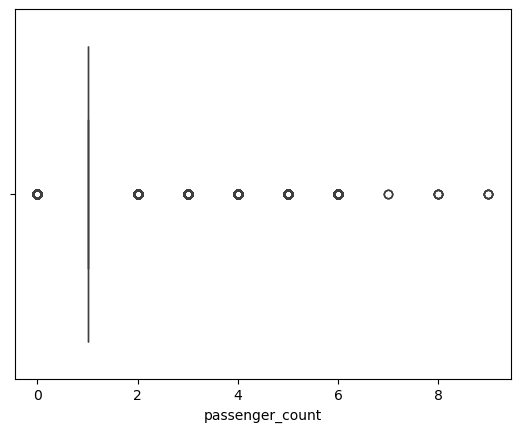

In [390]:
sns.boxplot(x=data['passenger_count'])

<Axes: xlabel='trip_distance'>

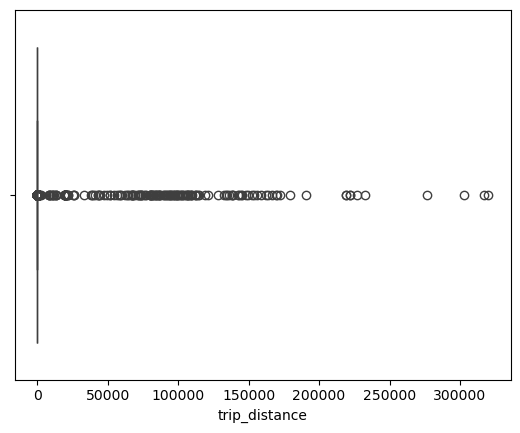

In [391]:
sns.boxplot(x=data['trip_distance'])

In [404]:
len(data)

3943264

In [405]:
(data['trip_distance']>150).sum()

213

In [418]:
((data['trip_distance']>100).sum()/len(data))*100

0.0

In [410]:
df = data.copy()
upper_cap = df['trip_distance'].quantile(0.99)
df['trip_distance_capped'] = df['trip_distance'].clip(upper=upper_cap)

In [415]:
data=data[data['trip_distance']<=100]

<Axes: xlabel='trip_distance'>

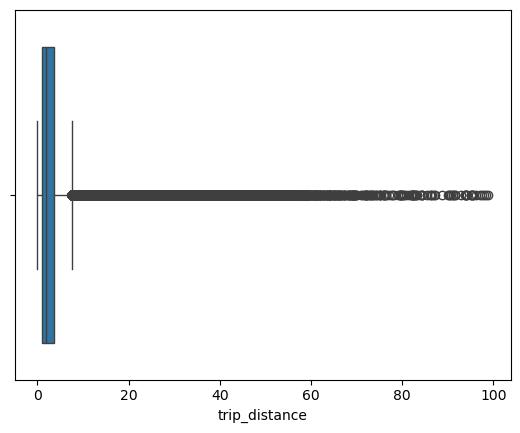

In [416]:
sns.boxplot(x=data['trip_distance'])

<Axes: xlabel='trip_distance', ylabel='Count'>

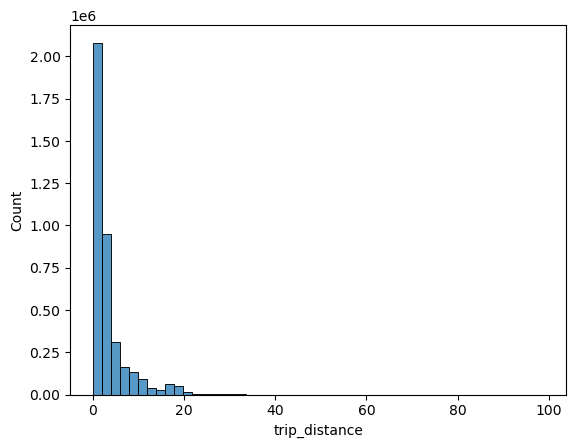

In [438]:
sns.histplot(x=data['trip_distance'], bins=50)

In [419]:
bins= [0, 5, 10, 20, 30, 50, 100]
labels = ['0-5km', '5-10km', '10-20km', '20-30km', '30-50km', '50-100km']
data['Distance_Bin'] = pd.cut(data['trip_distance'], bins=bins, labels=labels, right=False)

In [420]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date,Hour,Month,Total Congestion Surcharge,Distance_Bin
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,1.0,32.75,2.5,0.0,0.00,2025-01-08,12,1,2.50,0-5km
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,1.0,18.10,NaN,NaN,0.00,2025-01-12,15,1,0.00,0-5km
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,1.0,18.25,2.5,0.0,0.75,2025-01-22,10,1,3.25,0-5km
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,1.0,17.95,2.5,0.0,0.75,2025-01-21,19,1,3.25,0-5km
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,1.0,12.22,0.0,0.0,0.00,2025-01-17,14,1,0.00,0-5km
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,1.0,13.85,2.5,0.0,0.75,2025-10-26,21,10,3.25,0-5km
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,1.0,9.80,2.5,0.0,0.00,2025-10-04,12,10,2.50,0-5km
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,1.0,7.23,NaN,NaN,0.75,2025-10-21,20,10,0.00,5-10km
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,1.0,24.72,0.0,0.0,0.00,2025-10-04,15,10,0.00,0-5km


In [421]:
data['Distance_Bin'].value_counts()

Distance_Bin
0-5km       3225375
5-10km       419985
10-20km      265223
20-30km       28912
30-50km        3045
50-100km        470
Name: count, dtype: int64

In [425]:
data.groupby('Distance_Bin')['passenger_count'].mean()

C:\Users\Shaaf\AppData\Local\Temp\ipykernel_24484\2950174359.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Distance_Bin
0-5km       1.283249
5-10km      1.287130
10-20km     1.384725
20-30km     1.425708
30-50km     1.410128
50-100km    1.418660
Name: passenger_count, dtype: float64

In [426]:
summary = data.groupby('Distance_Bin').agg(
    trips=('passenger_count', 'size'),
    total_passengers=('passenger_count', 'sum'),
    avg_passengers=('passenger_count', 'mean')
)

summary

C:\Users\Shaaf\AppData\Local\Temp\ipykernel_24484\3643262232.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,trips,total_passengers,avg_passengers
Distance_Bin,,,
0-5km,3225375,3208513.0,1.283249
5-10km,419985,332561.0,1.287130
10-20km,265223,308863.0,1.384725
20-30km,28912,38266.0,1.425708
30-50km,3045,3954.0,1.410128
50-100km,470,593.0,1.418660


In [427]:
fig = px.bar(
    summary.reset_index(),
    x='Distance_Bin',
    y='trips',
    title="Trips by Distance Range"
)

fig.show()

In [428]:
fig = px.line(
    summary.reset_index(),
    x='Distance_Bin',
    y='avg_passengers',
    markers=True,
    title="Average Passengers per Trip vs Distance"
)

fig.show()

In [439]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date,Hour,Month,Total Congestion Surcharge,Distance_Bin
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,1.0,32.75,2.5,0.0,0.00,2025-01-08,12,1,2.50,0-5km
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,1.0,18.10,NaN,NaN,0.00,2025-01-12,15,1,0.00,0-5km
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,1.0,18.25,2.5,0.0,0.75,2025-01-22,10,1,3.25,0-5km
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,1.0,17.95,2.5,0.0,0.75,2025-01-21,19,1,3.25,0-5km
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,1.0,12.22,0.0,0.0,0.00,2025-01-17,14,1,0.00,0-5km
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,1.0,13.85,2.5,0.0,0.75,2025-10-26,21,10,3.25,0-5km
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,1.0,9.80,2.5,0.0,0.00,2025-10-04,12,10,2.50,0-5km
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,1.0,7.23,NaN,NaN,0.75,2025-10-21,20,10,0.00,5-10km
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,1.0,24.72,0.0,0.0,0.00,2025-10-04,15,10,0.00,0-5km


In [440]:
data.groupby('Distance_Bin')['Hour'].mean()

C:\Users\Shaaf\AppData\Local\Temp\ipykernel_24484\4162095137.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Distance_Bin
0-5km       14.383769
5-10km      13.691644
10-20km     13.724654
20-30km     14.224889
30-50km     14.056486
50-100km    14.363830
Name: Hour, dtype: float64

In [441]:
data['is_weekend'] = data['tpep_pickup_datetime'].dt.dayofweek >= 5

In [442]:
hourly = data.groupby(['Hour', 'is_weekend']).size().reset_index(name='trips')

In [443]:
hourly

,Hour,is_weekend,trips
0,0,False,56558
1,0,True,67105
2,1,False,28647
3,1,True,52745
4,2,False,15877
5,2,True,37935
6,3,False,10771
7,3,True,25759
8,4,False,12251
9,4,True,16204


In [445]:
px.line(
    hourly,
    x='Hour',
    y='trips',
    color='is_weekend',
    markers=True,
    title="Hourly Travel Demand: Weekday vs Weekend",
    color_discrete_map={True: 'orange', False: 'blue'}
)

In [446]:
data[['tpep_pickup_datetime', 'is_weekend']].head(10)

,tpep_pickup_datetime,is_weekend
0,2025-01-08 12:55:37,False
1,2025-01-12 15:08:16,True
2,2025-01-22 10:18:58,False
3,2025-01-21 19:36:32,False
4,2025-01-17 14:41:37,False
5,2025-01-10 23:33:36,False
6,2025-01-29 13:54:04,False
7,2025-01-13 21:44:42,False
8,2025-01-30 23:50:41,False
9,2025-01-02 00:35:52,False


In [477]:
data

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,Date,Hour,Month,Total Congestion Surcharge,Distance_Bin,is_weekend
0,1,2025-01-08 12:55:37,2025-01-08 13:23:57,1.0,3.50,1.0,N,166,262,1,...,32.75,2.5,0.0,0.00,2025-01-08,12,1,2.50,0-5km,False
1,2,2025-01-12 15:08:16,2025-01-12 15:16:15,NaN,1.26,NaN,None,41,75,0,...,18.10,NaN,NaN,0.00,2025-01-12,15,1,0.00,0-5km,True
2,2,2025-01-22 10:18:58,2025-01-22 10:32:20,2.0,1.73,1.0,N,164,144,4,...,18.25,2.5,0.0,0.75,2025-01-22,10,1,3.25,0-5km,False
3,2,2025-01-21 19:36:32,2025-01-21 19:46:12,1.0,1.47,1.0,N,107,186,2,...,17.95,2.5,0.0,0.75,2025-01-21,19,1,3.25,0-5km,False
4,2,2025-01-17 14:41:37,2025-01-17 14:47:38,1.0,0.81,1.0,N,75,74,1,...,12.22,0.0,0.0,0.00,2025-01-17,14,1,0.00,0-5km,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023615,1,2025-10-26 21:24:08,2025-10-26 21:28:14,1.0,0.60,1.0,N,48,246,1,...,13.85,2.5,0.0,0.75,2025-10-26,21,10,3.25,0-5km,True
4023616,1,2025-10-04 12:11:26,2025-10-04 12:15:45,1.0,0.80,1.0,N,237,263,2,...,9.80,2.5,0.0,0.00,2025-10-04,12,10,2.50,0-5km,True
4023617,2,2025-10-21 20:24:52,2025-10-21 21:02:30,NaN,6.68,NaN,None,107,238,0,...,7.23,NaN,NaN,0.75,2025-10-21,20,10,0.00,5-10km,False
4023618,2,2025-10-04 15:15:22,2025-10-04 15:31:20,2.0,3.39,1.0,N,65,255,1,...,24.72,0.0,0.0,0.00,2025-10-04,15,10,0.00,0-5km,True


In [448]:
hourly

,Hour,is_weekend,trips
0,0,False,56558
1,0,True,67105
2,1,False,28647
3,1,True,52745
4,2,False,15877
5,2,True,37935
6,3,False,10771
7,3,True,25759
8,4,False,12251
9,4,True,16204


In [478]:
hourly_demand = (
    data
    .set_index('Date')
    .resample('H')
    .size()
    .reset_index(name='trips')
)

C:\Users\Shaaf\AppData\Local\Temp\ipykernel_24484\3775690510.py:4: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.



In [508]:
hourly_demand

,Date,trips,naive_forecast,error,Hour
24,2025-01-02 00:00:00,8219,8436.0,-217.0,0
25,2025-01-02 01:00:00,0,0.0,0.0,1
26,2025-01-02 02:00:00,0,0.0,0.0,2
27,2025-01-02 03:00:00,0,0.0,0.0,3
28,2025-01-02 04:00:00,0,0.0,0.0,4
...,...,...,...,...,...
7268,2025-10-30 20:00:00,0,0.0,0.0,20
7269,2025-10-30 21:00:00,0,0.0,0.0,21
7270,2025-10-30 22:00:00,0,0.0,0.0,22
7271,2025-10-30 23:00:00,0,0.0,0.0,23


In [454]:
import plotly.express as px
px.line(
    hourly_demand,
    x='Date',
    y='trips',
    title='Hourly Demand Over Time',
    labels={'trips': 'Number of Trips', 'Date': 'Date and Hour'}
)


In [480]:
hourly_demand['naive_forecast'] = hourly_demand['trips'].shift(24)

In [481]:
hourly_demand.dropna(inplace=True)

In [482]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
mae = mean_absolute_error(hourly_demand['trips'], hourly_demand['naive_forecast'])
rmse = mean_squared_error(hourly_demand['trips'], hourly_demand['naive_forecast'], squared=False)
print(f"Mean Absolute Error (MAE): {mae}")
print(f"Root Mean Squared Error (RMSE): {rmse}")

Mean Absolute Error (MAE): 52.08663263898469
Root Mean Squared Error (RMSE): 303.43850616626946


c:\Users\Shaaf\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:483: FutureWarning:

'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.



In [483]:
mae / hourly_demand['trips'].mean()

0.09596362909936373

In [ ]:
# hourly_demand['Hour'] = hourly_demand['Date'].dt.hour

In [465]:
px.line(hourly_demand, x='Hour',
        y=['trips', 'naive_forecast'],
        title='Actual vs Naive Forecast (Hourly Demand)',
#!/usr/bin/env python3
        color_discrete_map={
            'trips': 'blue',
            'naive_forecast': 'red'
        })

In [484]:
hourly_demand

,Date,trips,naive_forecast
24,2025-01-02 00:00:00,8219,8436.0
25,2025-01-02 01:00:00,0,0.0
26,2025-01-02 02:00:00,0,0.0
27,2025-01-02 03:00:00,0,0.0
28,2025-01-02 04:00:00,0,0.0
...,...,...,...
7268,2025-10-30 20:00:00,0,0.0
7269,2025-10-30 21:00:00,0,0.0
7270,2025-10-30 22:00:00,0,0.0
7271,2025-10-30 23:00:00,0,0.0


In [ ]:
# hourly_demand['Date']=pd.to_datetime(hourly_demand['Date']).dt.date

In [496]:
january_data = hourly_demand[hourly_demand['Date'].dt.month == 1]

In [497]:
january_data

,Date,trips,naive_forecast,error,Hour
24,2025-01-02 00:00:00,8219,8436.0,-217.0,0
25,2025-01-02 01:00:00,0,0.0,0.0,1
26,2025-01-02 02:00:00,0,0.0,0.0,2
27,2025-01-02 03:00:00,0,0.0,0.0,3
28,2025-01-02 04:00:00,0,0.0,0.0,4
...,...,...,...,...,...
739,2025-01-31 19:00:00,0,0.0,0.0,19
740,2025-01-31 20:00:00,0,0.0,0.0,20
741,2025-01-31 21:00:00,0,0.0,0.0,21
742,2025-01-31 22:00:00,0,0.0,0.0,22


In [498]:
px.line(january_data, x='Hour',
        y=['trips', 'naive_forecast'],
        title='Actual vs Naive Forecast (Hourly Demand)',   
        color_discrete_map={
            'trips': 'blue',
            'naive_forecast': 'red'
        })

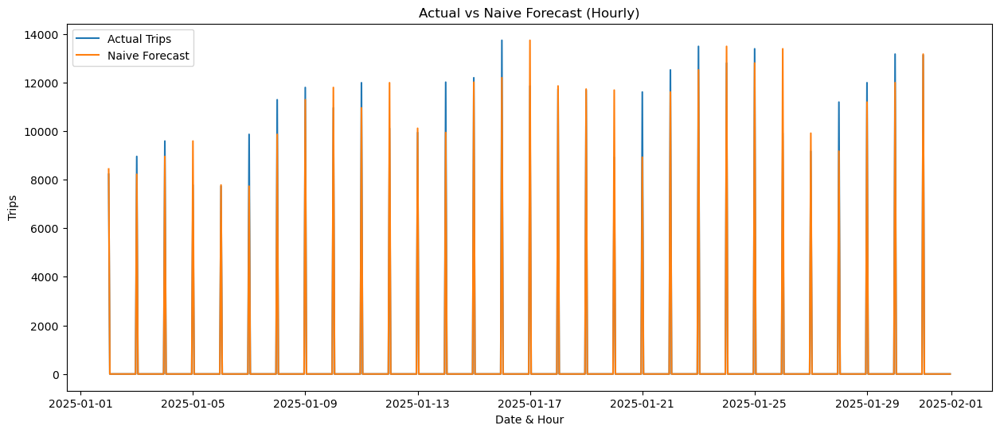

In [499]:
plt.figure(figsize=(15, 6))

sns.lineplot(x=january_data['Date'], y=january_data['trips'], label='Actual Trips')
sns.lineplot(x=january_data['Date'], y=january_data['naive_forecast'], label='Naive Forecast')

plt.xlabel('Date & Hour')
plt.ylabel('Trips')
plt.title('Actual vs Naive Forecast (Hourly)')
plt.legend()
plt.show()

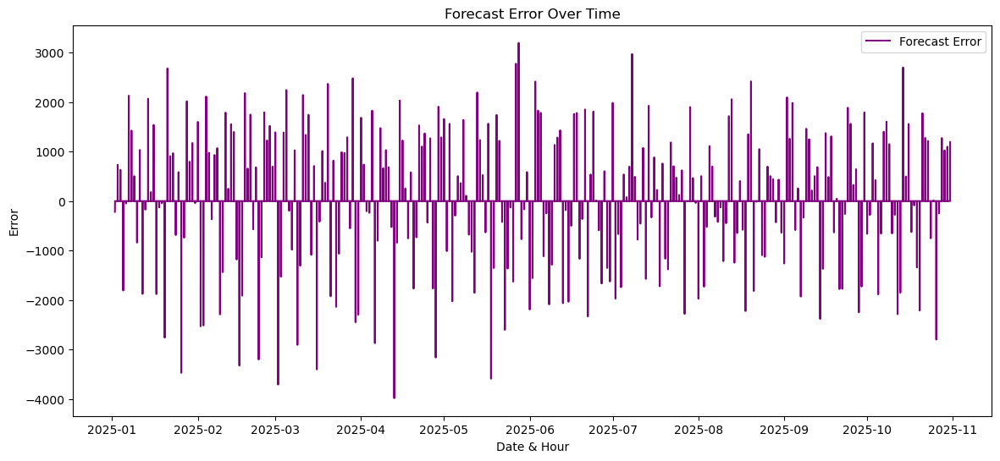

In [486]:
hourly_demand['error'] = hourly_demand['trips'] - hourly_demand['naive_forecast']
plt.figure(figsize=(14, 6))
plt.plot(hourly_demand['Date'], hourly_demand['error'], label='Forecast Error', color='purple')
plt.xlabel('Date & Hour')   
plt.ylabel('Error')
plt.title('Forecast Error Over Time')
plt.legend()
plt.show()

In [489]:
hourly_demand['Hour'] = hourly_demand['Date'].dt.hour

In [490]:
#Error by hour of day
hourly_error = hourly_demand.groupby('Hour')['error'].mean()
hourly_error

Hour
0     26.640264
1      0.000000
2      0.000000
3      0.000000
4      0.000000
5      0.000000
6      0.000000
7      0.000000
8      0.000000
9      0.000000
10     0.000000
11     0.000000
12     0.000000
13     0.000000
14     0.000000
15     0.000000
16     0.000000
17     0.000000
18     0.000000
19     0.000000
20     0.000000
21     0.000000
22     0.000000
23     0.000000
Name: error, dtype: float64

In [500]:
from pmdarima import auto_arima

In [502]:
hourly_demand

,Date,trips,naive_forecast,error,Hour
24,2025-01-02 00:00:00,8219,8436.0,-217.0,0
25,2025-01-02 01:00:00,0,0.0,0.0,1
26,2025-01-02 02:00:00,0,0.0,0.0,2
27,2025-01-02 03:00:00,0,0.0,0.0,3
28,2025-01-02 04:00:00,0,0.0,0.0,4
...,...,...,...,...,...
7268,2025-10-30 20:00:00,0,0.0,0.0,20
7269,2025-10-30 21:00:00,0,0.0,0.0,21
7270,2025-10-30 22:00:00,0,0.0,0.0,22
7271,2025-10-30 23:00:00,0,0.0,0.0,23


In [503]:
hourly_demand.dtypes

Date              datetime64[ns]
trips                      int64
naive_forecast           float64
error                    float64
Hour                       int32
dtype: object

In [504]:
sarima_data = hourly_demand.set_index('Date')

In [505]:
sarima_data

,trips,naive_forecast,error,Hour
Date,,,,
2025-01-02 00:00:00,8219,8436.0,-217.0,0
2025-01-02 01:00:00,0,0.0,0.0,1
2025-01-02 02:00:00,0,0.0,0.0,2
2025-01-02 03:00:00,0,0.0,0.0,3
2025-01-02 04:00:00,0,0.0,0.0,4
...,...,...,...,...
2025-10-30 20:00:00,0,0.0,0.0,20
2025-10-30 21:00:00,0,0.0,0.0,21
2025-10-30 22:00:00,0,0.0,0.0,22


In [506]:
sarima_data=sarima_data.asfreq('H')

C:\Users\Shaaf\AppData\Local\Temp\ipykernel_24484\2837765055.py:1: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.



In [510]:
sarima_data.tail(20)

,trips,naive_forecast,error,Hour
Date,,,,
2025-10-30 05:00:00,0,0.0,0.0,5
2025-10-30 06:00:00,0,0.0,0.0,6
2025-10-30 07:00:00,0,0.0,0.0,7
2025-10-30 08:00:00,0,0.0,0.0,8
2025-10-30 09:00:00,0,0.0,0.0,9
2025-10-30 10:00:00,0,0.0,0.0,10
2025-10-30 11:00:00,0,0.0,0.0,11
2025-10-30 12:00:00,0,0.0,0.0,12
2025-10-30 13:00:00,0,0.0,0.0,13
